In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import morphology

In [2]:
def extract_main_contour(image):
    # convert image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # apply Gaussian Blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # adaptive threshold to handle variations in color intensity
    adaptive_thresh = cv2.adaptiveThreshold(blurred, 255,
                                            cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                            cv2.THRESH_BINARY_INV, 11, 2)

    # apply morphological operations to clean up image
    kernel = np.ones((10, 10), np.uint8)
    morph = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

    # find contours
    contours, _ = cv2.findContours(morph, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # return the largest contour
    return max(contours, key = cv2.contourArea)

In [3]:
def crop(img):
    contour = extract_main_contour(img)

    x, y, w, h = cv2.boundingRect(contour)

    mask = np.zeros_like(img)
    
    cv2.drawContours(mask, [contour], 0, (255, 255, 255), thickness = cv2.FILLED)
    
    intersected = cv2.bitwise_and(mask, img)

    return intersected[y:y + h, x:x + w]


def resize(img1, img2):
    contour_areas = list(map(lambda x: cv2.contourArea(extract_main_contour(x)), [img1, img2]))

    if contour_areas[0] < contour_areas[1]:
        return cv2.resize(img1, img2.shape[1::-1]), img2
    
    return img1, cv2.resize(img2, img1.shape[1::-1])


def rotate_image(image, angle):
    h, w = image.shape[:2]
    center = (w // 2, h // 2)

    # Calculate new dimensions after rotation
    radians = np.deg2rad(angle)
    new_w = int(abs(w * np.cos(radians)) + abs(h * np.sin(radians)))
    new_h = int(abs(h * np.cos(radians)) + abs(w * np.sin(radians)))

    # Update the rotation matrix for the new center and dimensions
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotation_matrix[0, 2] += (new_w - w) / 2
    rotation_matrix[1, 2] += (new_h - h) / 2

    return cv2.warpAffine(image, rotation_matrix, (new_w, new_h))


def maximize_overlap(img1, img2, stepsize, cropped = False, angles = np.arange(0, 360, 90)):
    # crop the images to their ROIs if not already done
    if not cropped:
        img1, img2 = crop(img1), crop(img2)

    # calculate overlap score for each angle
    scores = np.array([overlap_score(img1, img2, angle) for angle in angles])

    # find angle that maximizes overlap score
    best_angle = angles[np.argmax(scores)]

    curr_stepsize = angles[1] - angles[0]

    # base case
    if curr_stepsize <= stepsize:
        return best_angle

    # zoom in on the best angle from the previous function call
    new_angles = np.arange(best_angle - curr_stepsize, best_angle + curr_stepsize + 1, np.ceil(curr_stepsize/2))

    # recursively call the function on the updated array of angles
    return maximize_overlap(img1, img2, stepsize, True, new_angles)


def overlap_score(img1, img2, angle):
    # rotate and crop image 1
    img1 = crop(rotate_image(img1, angle))

    # get image dimensions
    heights = [img1.shape[0], img2.shape[0]]
    widths = [img1.shape[1], img2.shape[1]]

    # ensure that both dimensions of the rotated and reference images are within 50% of one another
    if max(max(heights)/min(heights), max(widths)/min(widths)) > 1.5:
        return 0
    
    # resize the images 
    img1, img2 = resize(img1, img2)

    intersection = cv2.bitwise_and(img1, img2)
    union = cv2.bitwise_or(img1, img2)
    
    return np.sum(intersection) / np.sum(union)


def align_images(imgs, stepsize = 1):
    img1, img2, img3 = imgs

    # align the images with respect to the h&e image (img1)
    best_angle1 = maximize_overlap(img2, img1, stepsize)
    best_angle2 = maximize_overlap(img3, img1, stepsize)

    img2 = crop(rotate_image(crop(img2), best_angle1))
    img3 = crop(rotate_image(crop(img3), best_angle2))

    img1 = crop(img1)
    
    return img1, img2, img3

In [4]:
def read(dir):
    return [cv2.imread(os.path.join(dir, slice)) for slice in os.listdir(dir)]

In [5]:
def extract_epithelium(img, output_dir):
    # Convert the image to RGB and YCrCb
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_ycrcb = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)
    
    # Binning the luminance (Y) channel
    lumma_bins_n = 20
    divisor = np.floor(255 / lumma_bins_n).astype(np.uint8)
    lumma_binned = np.floor(img_ycrcb[:, :, 0] / divisor).astype(np.uint8)
    
    # Find the most common luminance bin
    most_pixels_bin = -1
    most_pixels = 0
    for bin_i in range(0, lumma_bins_n + 1):
        n_pixels = np.count_nonzero(lumma_binned == bin_i)
        if n_pixels > most_pixels:
            most_pixels = n_pixels
            most_pixels_bin = bin_i

    background_bin = most_pixels_bin
    background = lumma_binned == background_bin
    background = morphology.remove_small_objects(background, 5000)
    background = morphology.remove_small_holes(background, 10000)

    # Binning the Cr (Red Chroma) channel
    Cr_bins_n = 50
    divisor = np.floor(255 / Cr_bins_n).astype(np.uint8)
    Cr_binned = np.floor(img_ycrcb[:, :, 2] / divisor).astype(np.uint8)
    
    # Find the most common Cr bin
    most_pixels_bin = -1
    most_pixels = 0
    for bin_i in range(0, Cr_bins_n + 1):
        n_pixels = np.count_nonzero(Cr_binned == bin_i)
        if n_pixels > most_pixels:
            most_pixels = n_pixels
            most_pixels_bin = bin_i

    # Stroma mask generation
    stroma_bin = most_pixels_bin
    stroma = Cr_binned == stroma_bin
    stroma = stroma + (Cr_binned == stroma_bin - 1)
    stroma = stroma + (Cr_binned == stroma_bin - 2)
    stroma = stroma * np.invert(background)
    stroma = morphology.dilation(stroma, morphology.square(3))
    stroma = morphology.remove_small_objects(stroma, 1000)

    # Epithelia mask generation
    epithelia_bin = stroma_bin + 2
    epithelia = Cr_binned == epithelia_bin
    epithelia = epithelia + (Cr_binned == epithelia_bin + 1)
    epithelia = epithelia + (Cr_binned == epithelia_bin + 2)
    epithelia = epithelia + (Cr_binned == epithelia_bin + 3)
    epithelia = epithelia + (Cr_binned == epithelia_bin + 4)
    epithelia = epithelia * np.invert(background)
    epithelia = epithelia * np.invert(stroma)
    epithelia = epithelia * np.invert(img_ycrcb[:, :, 1] < 120)
    epithelia = morphology.dilation(epithelia, morphology.square(2))
    epithelia = morphology.remove_small_objects(epithelia, 500)
    epithelia = morphology.remove_small_holes(epithelia, 10000)

    # Adjust stroma to only show areas not covered by epithelia
    stroma_only = stroma * np.invert(epithelia)  

    # Apply the masks to the original image 
    epithelia_img = cv2.bitwise_and(img_rgb, img_rgb, mask=(epithelia.astype(np.uint8) * 255))
    stroma_img = cv2.bitwise_and(img_rgb, img_rgb, mask=(stroma_only.astype(np.uint8) * 255))

    # Combine both epithelia and stroma images
    combined_img = cv2.add(epithelia_img, stroma_img)

    # Save the combined image
    combined_filename = os.path.join(output_dir, "epithelia_and_stroma_combined.png")
    cv2.imwrite(combined_filename, cv2.cvtColor(combined_img, cv2.COLOR_RGB2BGR), [cv2.IMWRITE_PNG_COMPRESSION, 0])
    print(f"Combined epithelium and stroma image saved at {combined_filename}")

    # Display the images on the same line using subplots
    fig, axs = plt.subplots(1, 3, figsize=(18, 6)) 
    axs[0].imshow(combined_img)
    axs[0].set_title("Epithelia and Stroma Combined")
    axs[0].axis('off')

    axs[1].imshow(epithelia_img)
    axs[1].set_title("Epithelia")
    axs[1].axis('off')

    axs[2].imshow(stroma_img)
    axs[2].set_title("Stroma")
    axs[2].axis('off')

    plt.tight_layout()
    plt.show()

    # Save the individual epithelium and stroma images if desired
    epithelia_filename = os.path.join(output_dir, "epithelia.tif")
    cv2.imwrite(epithelia_filename, cv2.cvtColor(epithelia_img, cv2.COLOR_RGB2BGR))
    print(f"Epithelia saved at {epithelia_filename}")

    stroma_filename = os.path.join(output_dir, "stroma.tif")
    cv2.imwrite(stroma_filename, cv2.cvtColor(stroma_img, cv2.COLOR_RGB2BGR))
    print(f"Stroma saved at {stroma_filename}")

In [6]:
def write(imgs, patient, match_name):
    output_dir = os.path.join('matches', patient, match_name)
    os.makedirs(output_dir, exist_ok = True)

    for i, img in enumerate(imgs, 1):
        # Save the aligned images
        cv2.imwrite(os.path.join(output_dir, f'slice{i}.tif'), img)

        # Only apply extract_epithelium on slice1 
        if i == 1:
            extract_epithelium(img, output_dir)

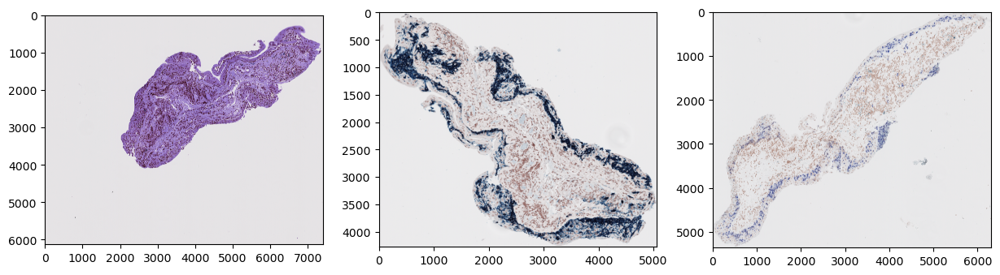

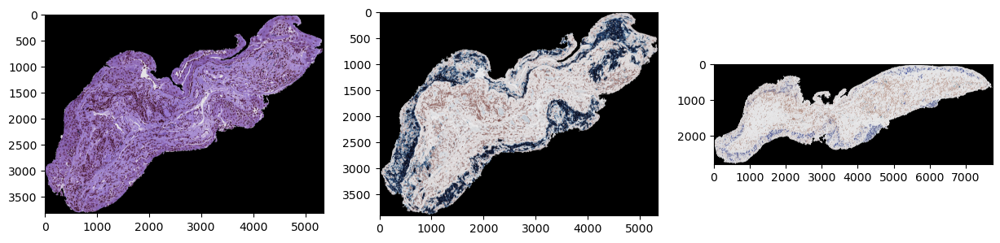

Combined epithelium and stroma image saved at matches/h2134537/match1/epithelia_and_stroma_combined.png


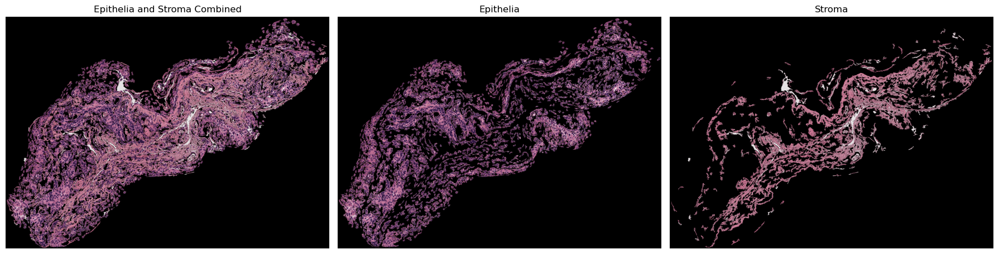

Epithelia saved at matches/h2134537/match1/epithelia.tif
Stroma saved at matches/h2134537/match1/stroma.tif


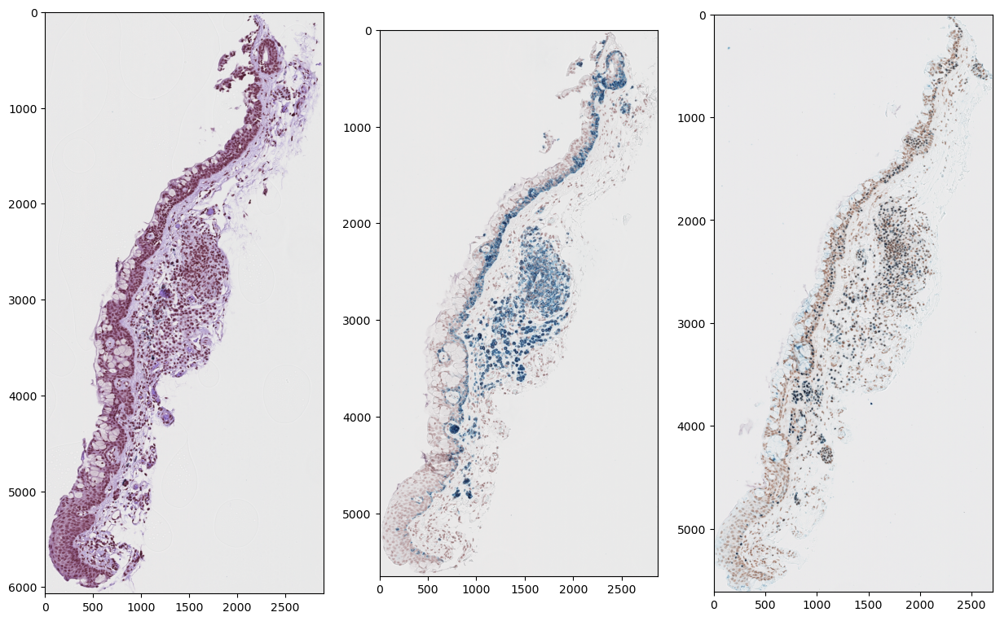

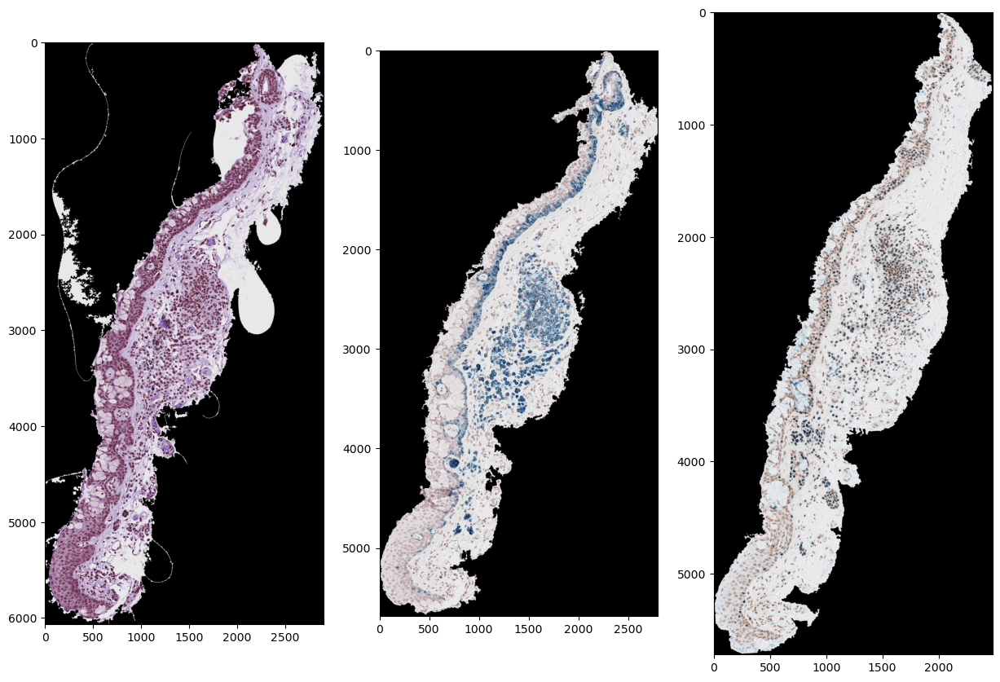

Combined epithelium and stroma image saved at matches/h2114173/match1/epithelia_and_stroma_combined.png


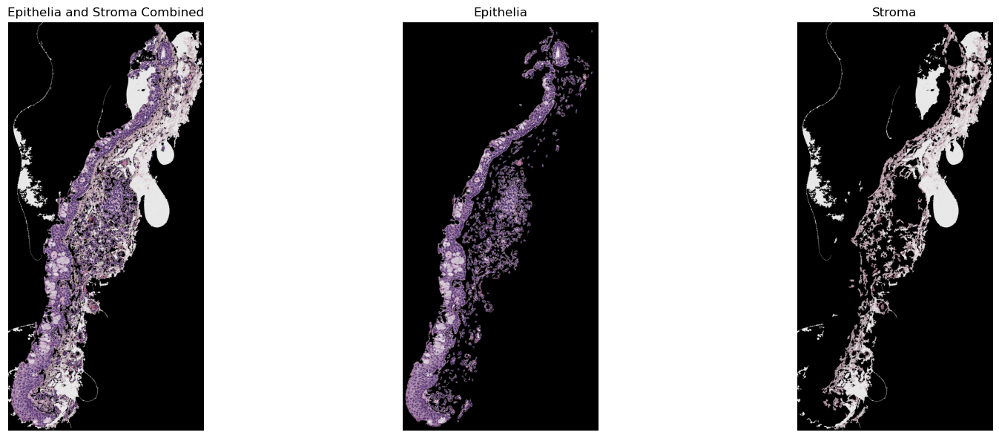

Epithelia saved at matches/h2114173/match1/epithelia.tif
Stroma saved at matches/h2114173/match1/stroma.tif


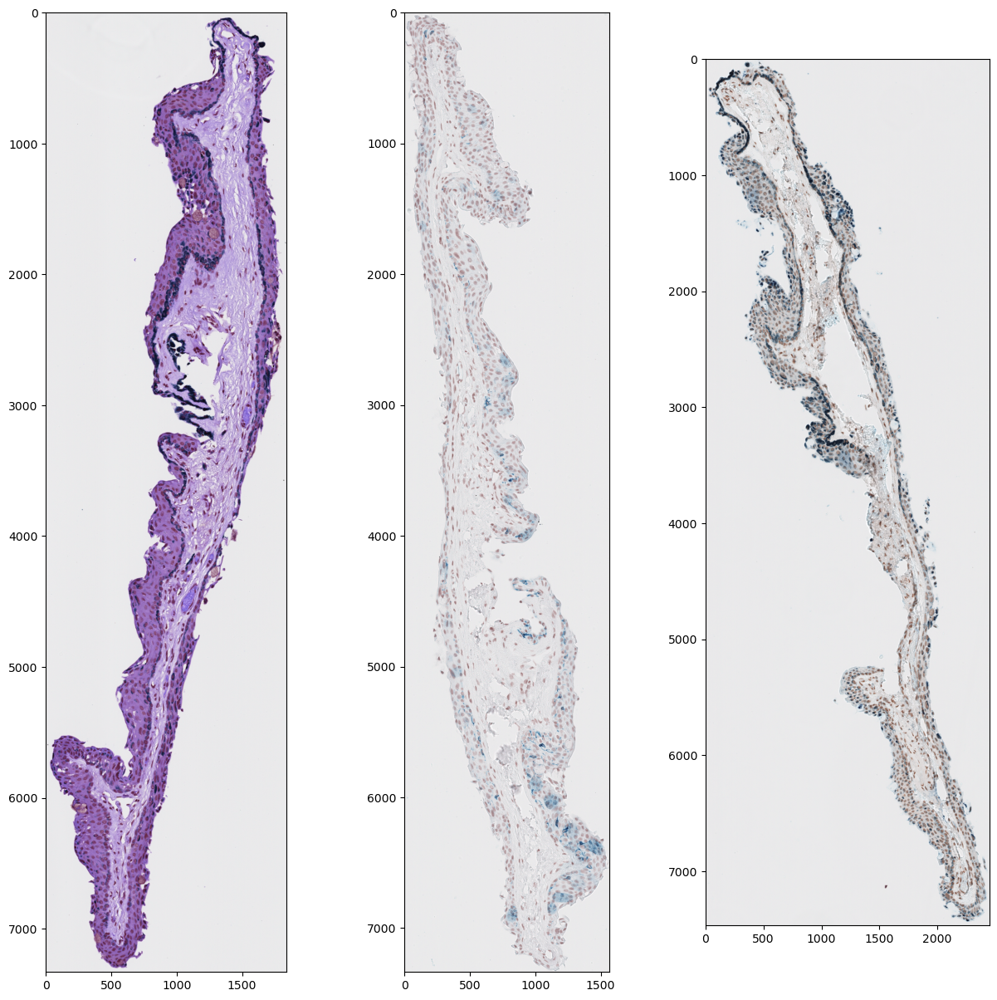

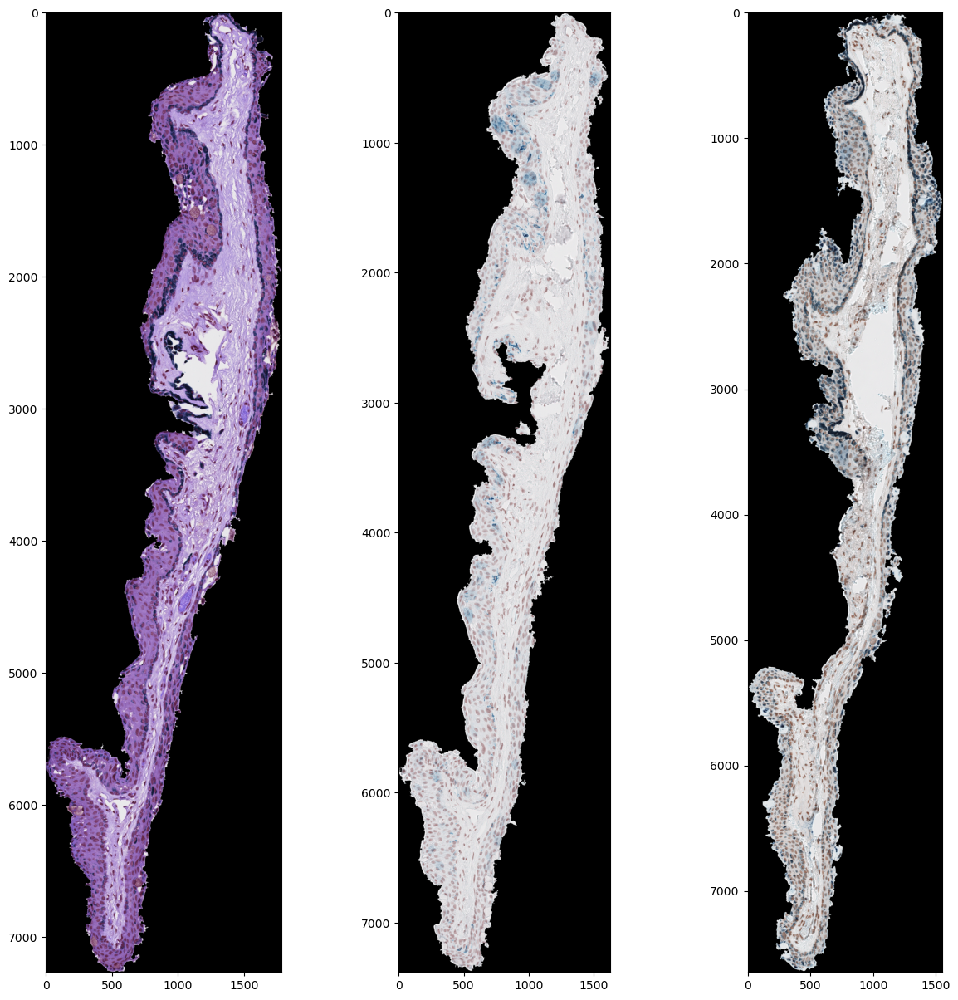

Combined epithelium and stroma image saved at matches/h2114156/match1/epithelia_and_stroma_combined.png


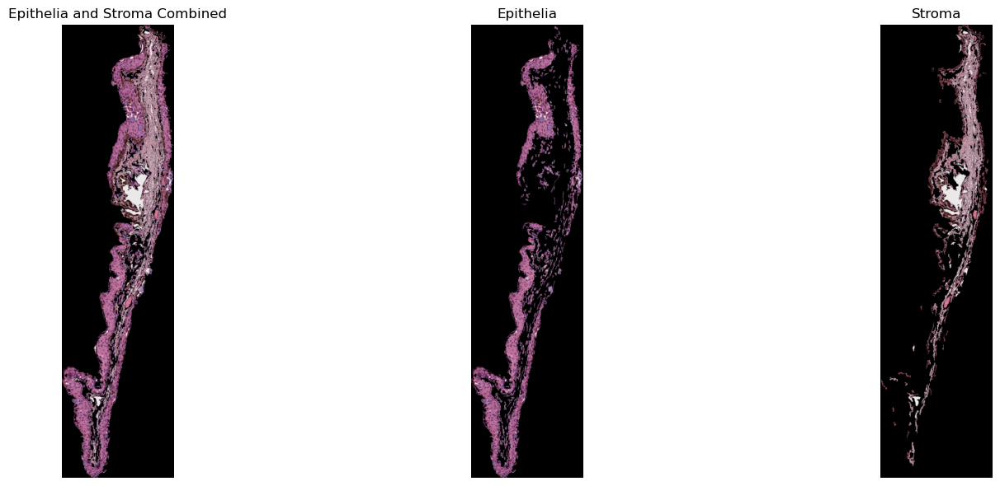

Epithelia saved at matches/h2114156/match1/epithelia.tif
Stroma saved at matches/h2114156/match1/stroma.tif


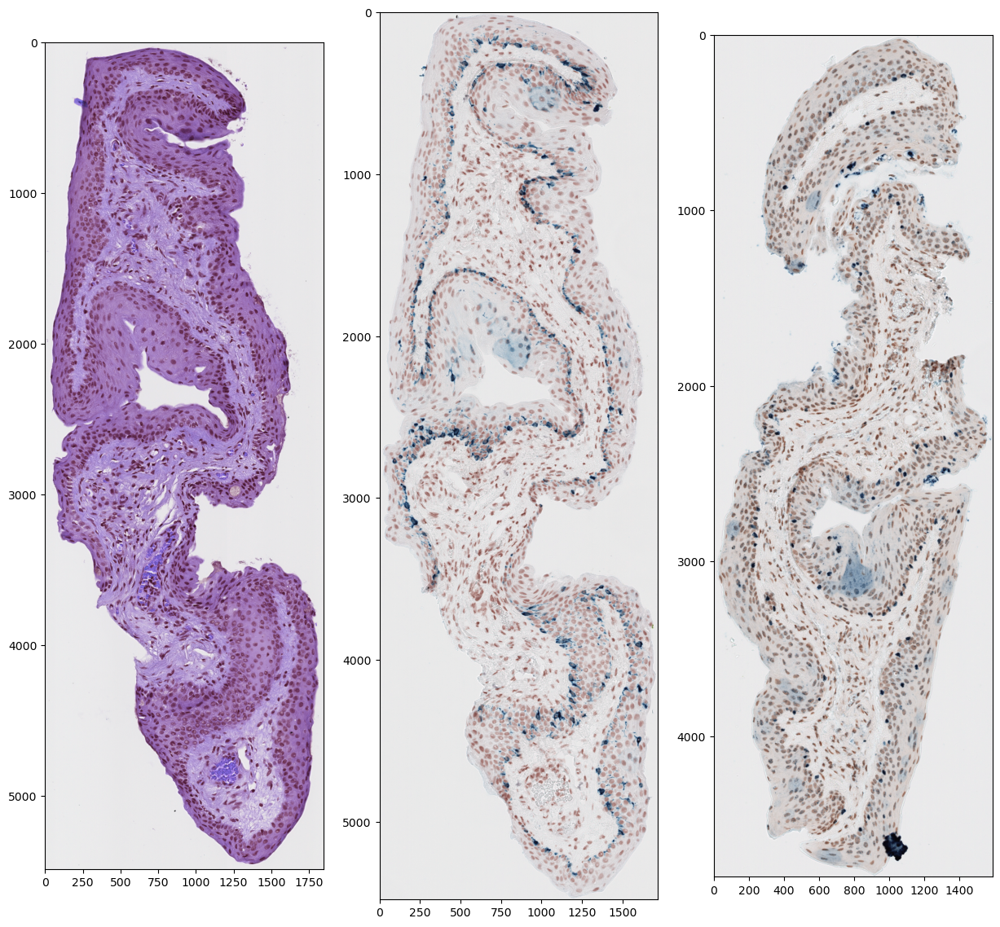

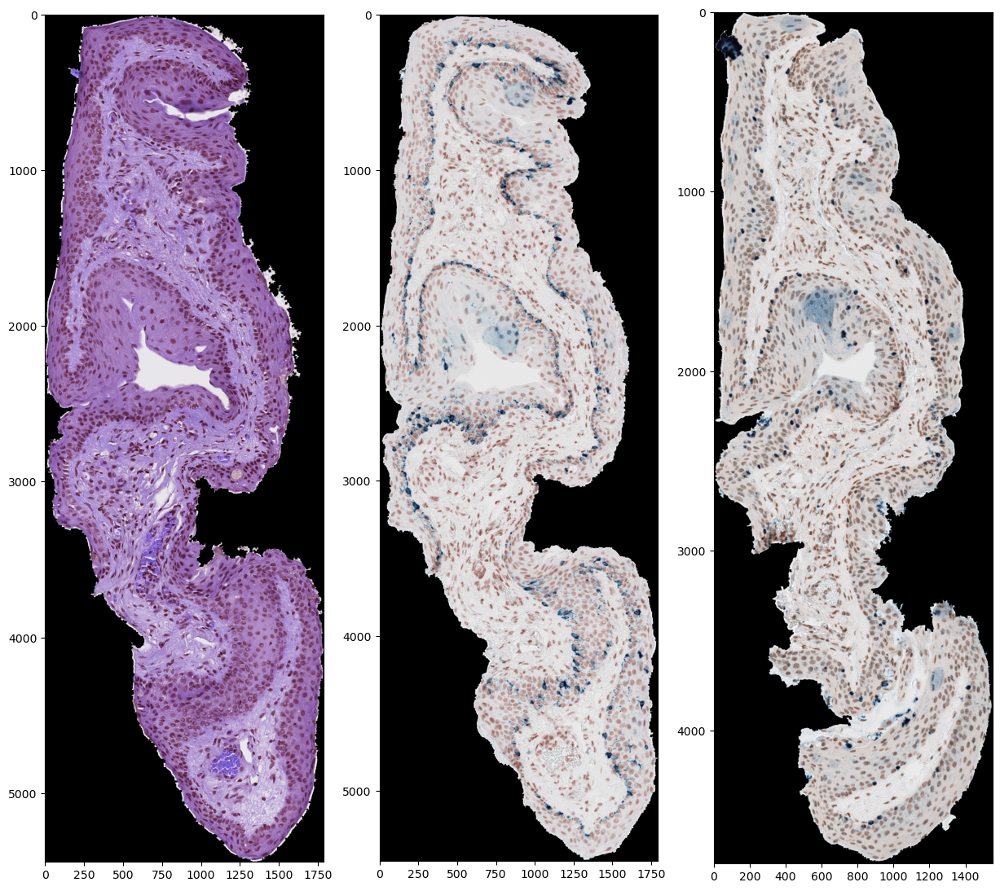

Combined epithelium and stroma image saved at matches/h2114154/match1/epithelia_and_stroma_combined.png


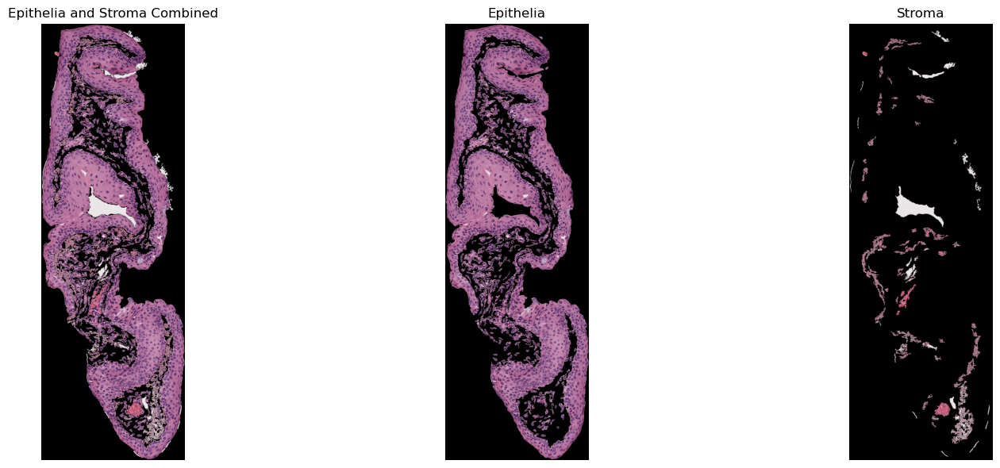

Epithelia saved at matches/h2114154/match1/epithelia.tif
Stroma saved at matches/h2114154/match1/stroma.tif


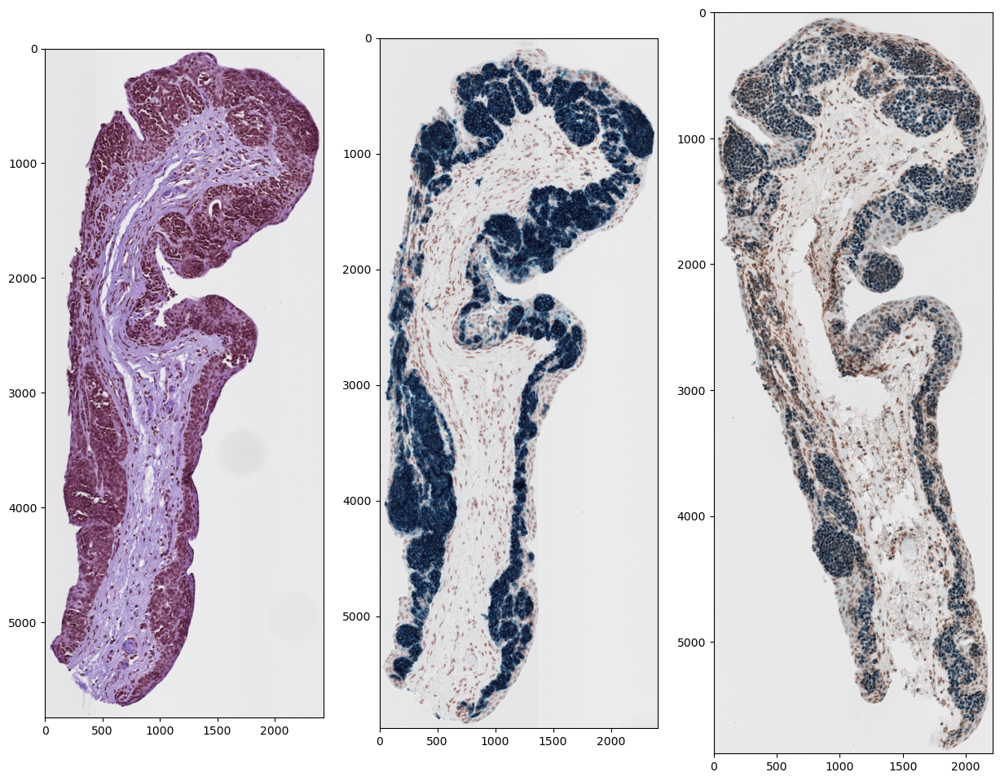

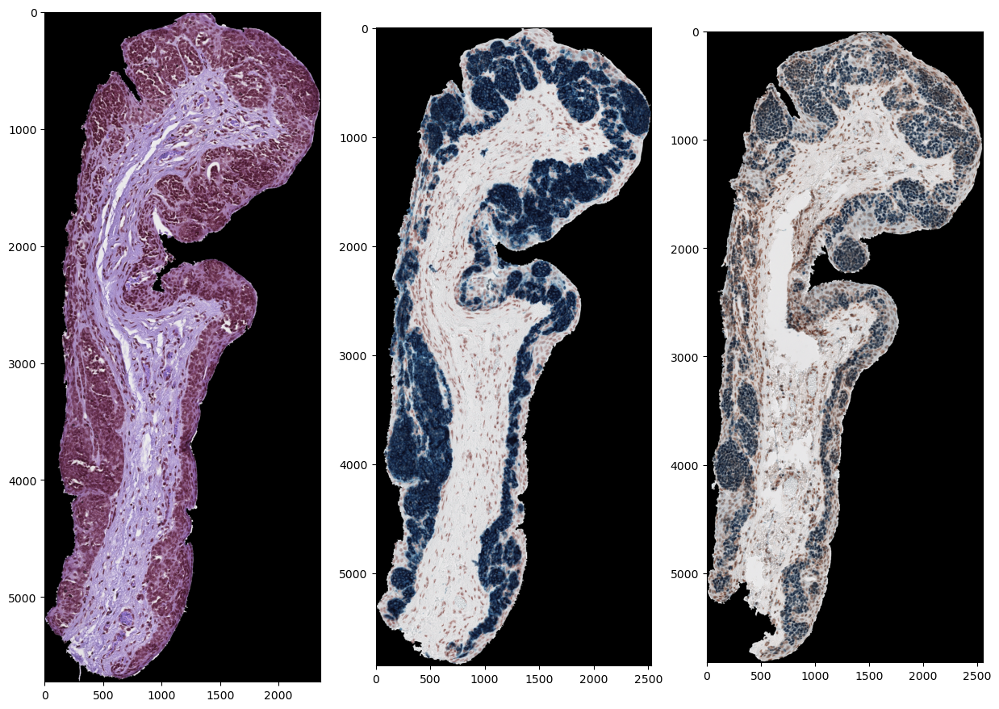

Combined epithelium and stroma image saved at matches/h2114153/match1/epithelia_and_stroma_combined.png


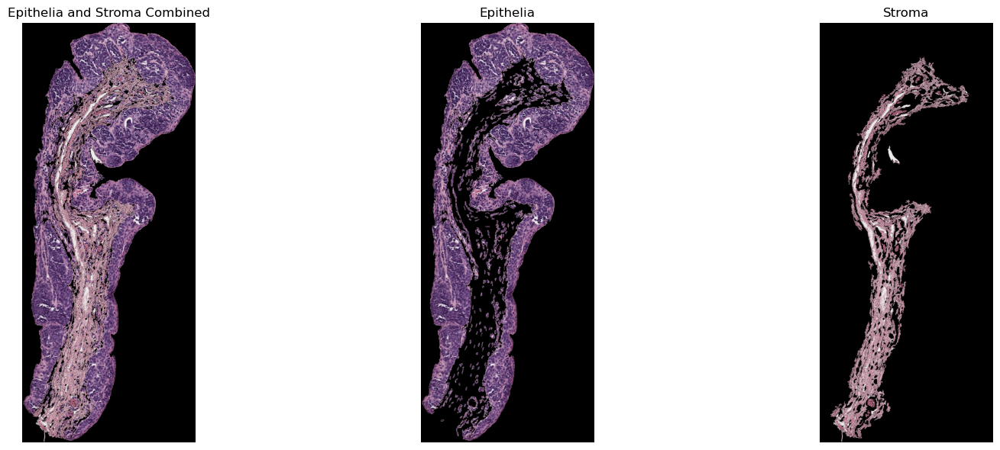

Epithelia saved at matches/h2114153/match1/epithelia.tif
Stroma saved at matches/h2114153/match1/stroma.tif


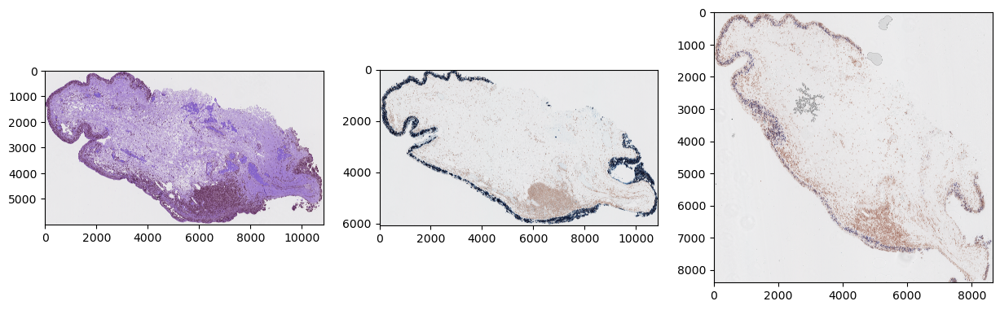

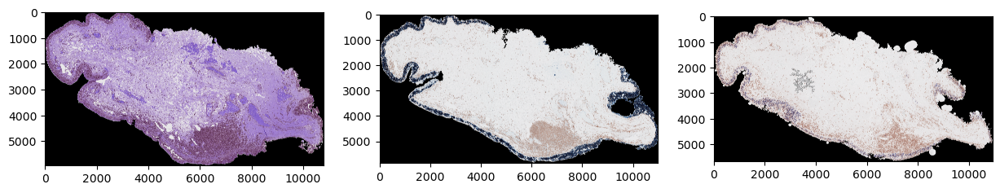

Combined epithelium and stroma image saved at matches/h2035361A/match1/epithelia_and_stroma_combined.png


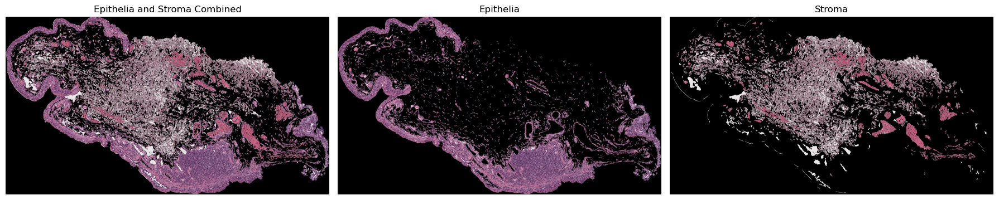

Epithelia saved at matches/h2035361A/match1/epithelia.tif
Stroma saved at matches/h2035361A/match1/stroma.tif


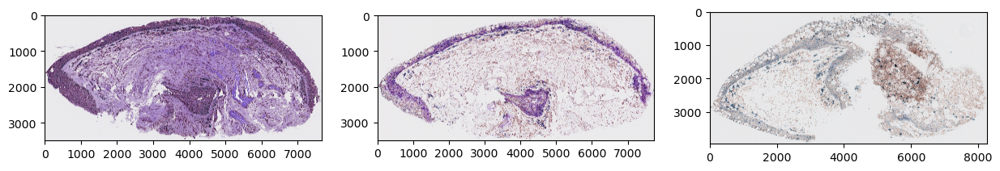

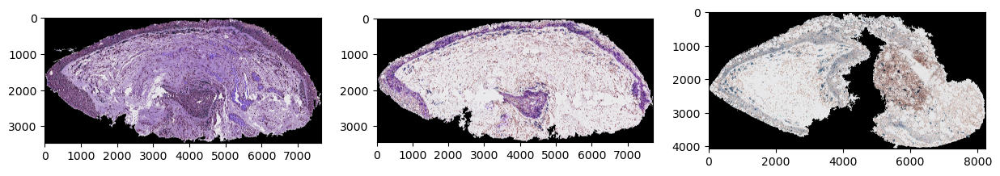

Combined epithelium and stroma image saved at matches/h2010714/match1/epithelia_and_stroma_combined.png


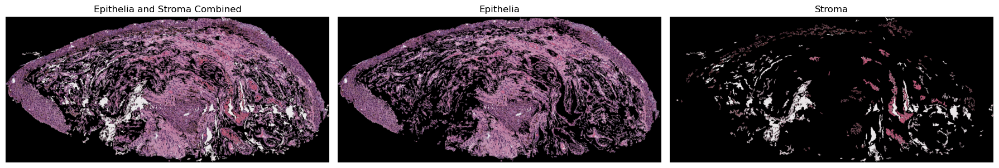

Epithelia saved at matches/h2010714/match1/epithelia.tif
Stroma saved at matches/h2010714/match1/stroma.tif


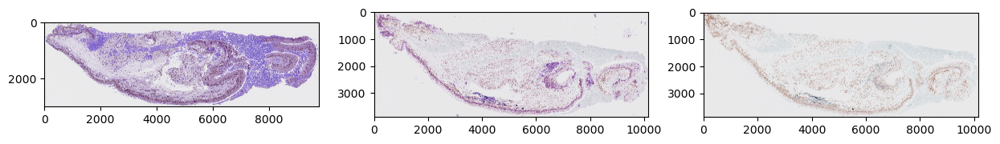

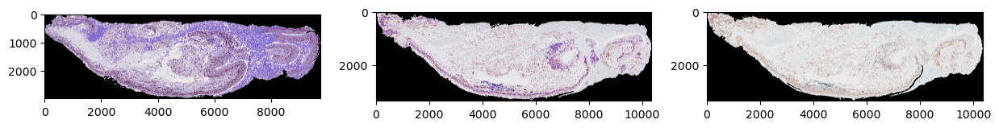

Combined epithelium and stroma image saved at matches/h1915192/match1/epithelia_and_stroma_combined.png


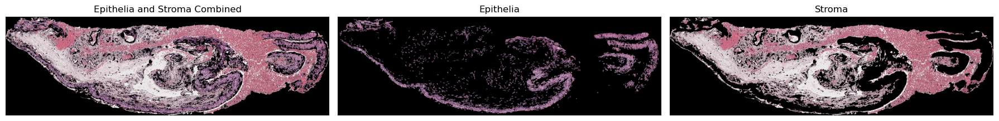

Epithelia saved at matches/h1915192/match1/epithelia.tif
Stroma saved at matches/h1915192/match1/stroma.tif


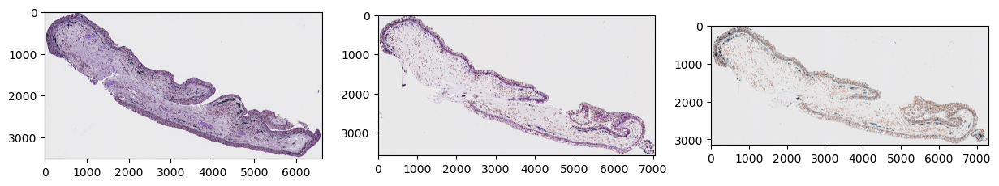

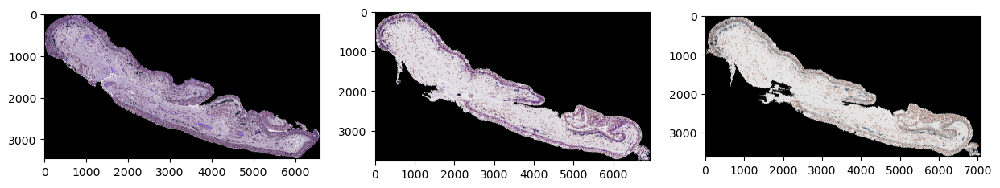

Combined epithelium and stroma image saved at matches/h1909027B/match1/epithelia_and_stroma_combined.png


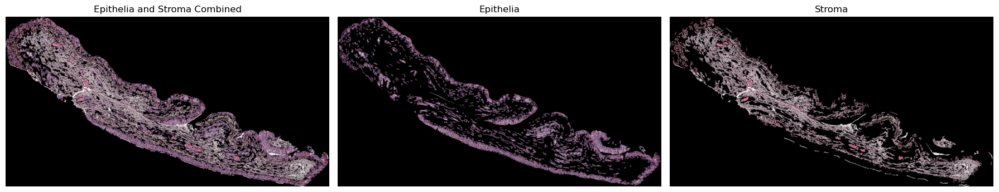

Epithelia saved at matches/h1909027B/match1/epithelia.tif
Stroma saved at matches/h1909027B/match1/stroma.tif


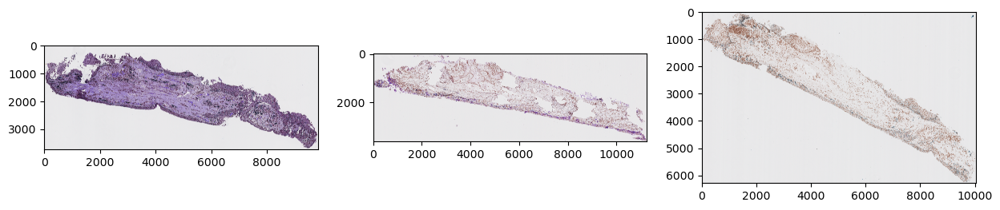

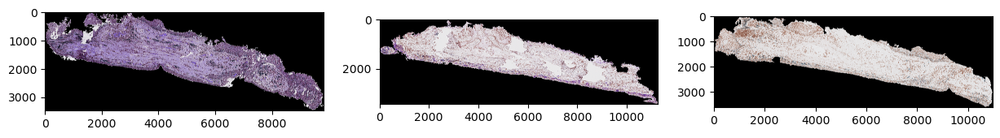

Combined epithelium and stroma image saved at matches/h1857578B/match1/epithelia_and_stroma_combined.png


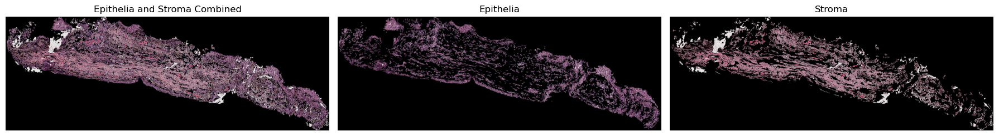

Epithelia saved at matches/h1857578B/match1/epithelia.tif
Stroma saved at matches/h1857578B/match1/stroma.tif


In [7]:
match_dir = 'matches2'

for patient in reversed(os.listdir(match_dir)):
    patient_dir = os.path.join(match_dir, patient)

    for match in os.listdir(patient_dir):
        if match.startswith('match'):
            imgs = read(os.path.join(patient_dir, match))

            # Display unaligned images
            _, axs = plt.subplots(1, 3, figsize = (15, 15))
            for i, img in enumerate(imgs):
                axs[i].imshow(img)

            plt.show()

            # Align the images (increase step size for faster processing)
            aligned_images = align_images(imgs, stepsize = 2)

            # Display aligned images
            _, axs = plt.subplots(1, 3, figsize = (15, 15))
            for i, a in enumerate(aligned_images):
                axs[i].imshow(a)

            plt.show()

            # Write the aligned images and also extract and save the epithelium and stroma images
            write(aligned_images, patient, match)